# 0. Installing/importing libraries

In [ ]:
#installing twint

# installing this particular version of twint so that this error https://github.com/twintproject/twint/issues/915 does not appear
!python -m pip install git+https://github.com/twintproject/twint.git@origin/master#egg=twint

  Cloning https://github.com/twintproject/twint.git (to revision origin/master) to /tmp/pip-install-zhn9n9py/twint
  Running command git clone -q https://github.com/twintproject/twint.git /tmp/pip-install-zhn9n9py/twint
  Running command git checkout -q origin/master
     |████████████████████████████████| 1.3MB 7.9MB/s 
     |████████████████████████████████| 266kB 25.8MB/s 
     |████████████████████████████████| 348kB 40.2MB/s 
     |████████████████████████████████| 143kB 41.0MB/s 
     |████████████████████████████████| 296kB 20.3MB/s 
     |████████████████████████████████| 235kB 40.9MB/s 
  Created wheel for twint: filename=twint-2.1.21-cp37-none-any.whl size=38863 sha256=e396d59ae106d5ce11ff8ef1fc4394de4d231d14f59b320e59e46ca141486623
  Stored in directory: /tmp/pip-ephem-wheel-cache-u0bee_pr/wheels/4f/3b/75/62d04b3b446658ba85401e8868d3cd1d4bc22f17ad755460a6
  Created wheel for fake-useragent: filename=fake_useragent-0.1.11-cp37-none-any.whl size=13485 sha256=9b0b616921f3dfbe41

In [ ]:
# this is done so that twint works with jupyter notebook
import nest_asyncio
nest_asyncio.apply()
import twint
import datascience as dt
import pandas as pd
import numpy as np
import time
import matplotlib.pyplot as plt
%matplotlib inline
import scipy
from statsmodels.stats.weightstats import ztest
import datetime
from pathlib import Path
import os

/usr/local/lib/python3.7/dist-packages/datascience/tables.py:17: MatplotlibDeprecationWarning: The 'warn' parameter of use() is deprecated since Matplotlib 3.1 and will be removed in 3.3.  If any parameter follows 'warn', they should be pass as keyword, not positionally.
  matplotlib.use('agg', warn=False)
/usr/local/lib/python3.7/dist-packages/datascience/util.py:10: MatplotlibDeprecationWarning: The 'warn' parameter of use() is deprecated since Matplotlib 3.1 and will be removed in 3.3.  If any parameter follows 'warn', they should be pass as keyword, not positionally.
  matplotlib.use('agg', warn=False)
/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


# 1. Scraping tweets

In [ ]:
def dumper(search_terms, since, until, file_path, limit = 1000, location = 0):
  """
  **This function saves the scraped tweets to a file path with these parameters**

  *search_terms* with OR and AND logic operators

  *since* starting date in unicode date format

  *until* ending date

  *file_path* where to save

  *limit* how many tweets to scrape
  
  """

  start = time.time() 
  # Configure

  c = twint.Config()
#  c.Custom['tweet'] = ['id', 'location', 'date', 'time']
  c.Search = search_terms
  c.Hide_output = True
  c.Store_csv = True
  c.Lang = 'en'
  c.Since = since
  c.Pandas = True
  c.Until = until
  c.Limit = limit
  c.Output = file_path
  if location != 0:
    c.Near = location
#  c.Location = True

  # Run
  twint.run.Search(c)
  print(time.time() - start)

In [10]:
def date_to_days(since, until):
  """

  ***This function takes in since and until dates in ISO format and returns a list of all the dates in between***

  """
  dates = []
  start = datetime.date.fromisoformat(since)  
  end   = datetime.date.fromisoformat(until)
  day   = start
  while day <= end:
    dates.append(str(day))
    day += datetime.timedelta(days = 1)
  return dates

In [ ]:
#scraping 1000 tweets per day from Jan 01, 2020 to Mar 31, 2021
#the reason it is done by day is to assure even distribution of tweets in time

file = 'tweets.csv'

for day in date_to_days('2020-01-01', '2021-03-31'):
  dumper('corona OR lockdown', day[0], day[1], file, limit = 1000)
  print(day[0].split(' ')[0] + ' is done')

#sometimes twint might fail at some date. Since I am lazy, I manually restarted this block by changing the date to the one 
#where it failed

# 2. Sentiment analysis

In [ ]:
import nltk
nltk.download(['vader_lexicon'])
from nltk.sentiment import SentimentIntensityAnalyzer as sia

In [ ]:
#reading the table 

table = pd.read_csv(file)

In [ ]:
#saving the tweets with their sentiment in a new csv file

combined = []
neutral = []
positive = []
negative = []
counter = 0

for tweet in table['tweet']:
  print(counter, ' out of ', len(table.index))
  score = sia().polarity_scores(tweet)
  combined.append(score['compound'])
  positive.append(score['pos'])
  negative.append(score['neg'])
  neutral.append(score['neu'])
  counter += 1

table['combined'] = combined
table['positive'] = positive
table['negative'] = negative
table['neutral' ] = neutral


file1 = 'tweets_with_sentiment.csv'
table.to_csv(file1)

In [ ]:
#reading the new table

table = pd.read_csv(file1)

# 3. Creating a word cloud

## 3.1 Cleaning the words in tweets

In [ ]:
#This block is using the code provided in the course

import nltk
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')
import string
import re


def text_lowercase(text):
    return text.lower()

def remove_numbers(text):
    result = re.sub(r'\d+', '', text)
    return result

def remove_punctuation(text):
    translator = str.maketrans('', '', string.punctuation)
    return text.translate(translator)

def remove_whitespace(text):
    return  " ".join(text.strip().split())

from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
  
# remove stopwords function
def remove_stopwords(text):
    stop_words = set(stopwords.words("english"))
    word_tokens = word_tokenize(text)
    filtered_text = [word for word in word_tokens if word not in stop_words]
    return filtered_text

def remove_short_words(l_token):
    return [word for word in l_token if len(word)>3]


import re
import numpy as np
import pandas as pd
from pprint import pprint

# Gensim
import gensim
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel

# Enable logging for gensim - optional
import logging
logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.ERROR)

import warnings
warnings.filterwarnings("ignore",category=DeprecationWarning)

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.


In [ ]:
#processsing the tweets

preprocessed_custom = table['tweet'].dropna().apply(text_lowercase).apply(remove_numbers).apply(remove_punctuation).apply(remove_whitespace).apply(remove_stopwords).apply(remove_short_words).values.tolist()

In [6]:
#concatinating them together

text = ''
for array in preprocessed_custom:
  for word in array:
    text += word + ' '
text

'corona type spotbills steven nelson lockdown year disrespectful nytpolitics hoodies tshirts beachy touch dash psychopathic violence edgy pour corona tell lots things thatll make believe corona better take receive httpstcoajouopjc full sisters close hatches lockdown curlin yearlingsclose hatches colt lockdown filly full lockdown training focus recovery course httpstcokfgzpkemrh tonight ‼️tonight pull richbitchwednesdays continues queens capelliscafe northern blvd corona hangover party 🎉🔥‼️• everyone free night regular bottles all… httpstcoeigieisaqm think alcohol kind like pokémon cards byob party trade high life corona hugorelly lockdown drills time happy hour alert happy hour residences located pulpito started ends hours minutes well drinks wine corona pacifico victoria happyhourboard puertovallarta residencesskybar orakganakga legit except corona part okay bank account lockdown today onwards underratedathl jecori johnson lockdowncoverage hephzibah comprehensive high school class yea

## 3.2 Building the cloud

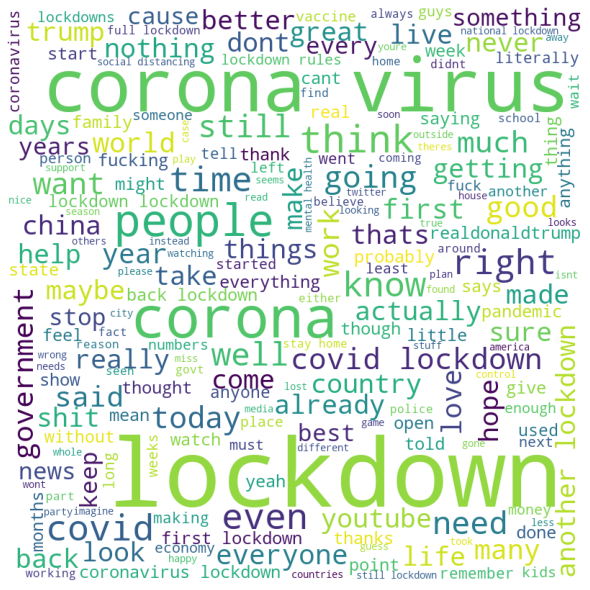

In [7]:
# This block is using the code from the following tutorial: https://www.geeksforgeeks.org/generating-word-cloud-python/

# Python program to generate WordCloud
  
# importing all necessery modules
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt
import pandas as pd

  
comment_words = ''
stopwords = set(STOPWORDS)
  
# iterate through the csv file
for val in text.split(' '):
      
    # typecaste each val to string
    val = str(val)
  
    # split the value
    tokens = val.split()
      
    # Converts each token into lowercase
    for i in range(len(tokens)):
        tokens[i] = tokens[i].lower()
      
    comment_words += " ".join(tokens)+" "
  
wordcloud = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                # collocations=False,
                normalize_plurals = False,
                min_font_size = 10).generate(comment_words)
  
# plot the WordCloud image                       
plt.figure(figsize = (8, 8), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
  
plt.show()

# 4. Plotting the overall and by keyterms sentiment

In [13]:
# now lets build a function that does this for any keyterm

def key_sentiment(table, term = 1, to_print = 0):
  """
  ***This function plots the sentiment by four categories if to_print = True***

  *table* is a pandas dataframe with tweets and their sentiments already computed

  *term* is a keyterm loc of the dataframe that includes only tweets from the dataset that have the term in them 
  default is 1, at which no loc is happening 

  *to_print* show the graphs is True

  ***returns a dictionary with the sentiments binned and averaged by days in four categories***

  """
  if term != 1:
    new = table.loc[table['tweet'].str.contains(term)].sort_values('date')
  else:
    new = table
  combined = []
  positive = []
  negative = []
  neutral  = []
  d = {'combined':combined,  'positive' : positive, 'negative':negative, 'neutral':neutral}
  shape = {'combined': ('blue', '.'),  'positive' : ('red', '+'), 'negative': ('green', 'x'), 'neutral': ('violet', '^')}

  for day in date_to_days(list(new['date'])[0], list(new['date'])[-1]):
    daily_tweets = new.loc[new['date'] == day]
    for key in d:
      d[key].append(np.average(daily_tweets[key]))
  
  if to_print: 
    for key in d:
      fig = plt.figure()
      plt.plot(d[key], shape[key][1], color = shape[key][0], label = key)
      plt.title('Overall sentiment')
      plt.xlabel('days')
      plt.legend()

  return d

/usr/local/lib/python3.7/dist-packages/numpy/lib/function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
/usr/local/lib/python3.7/dist-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


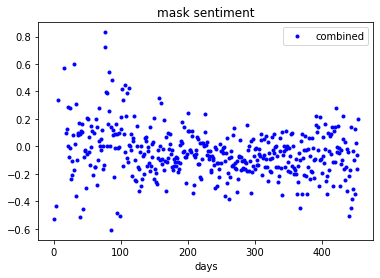

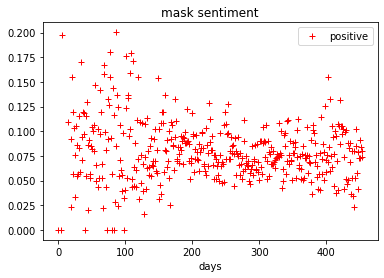

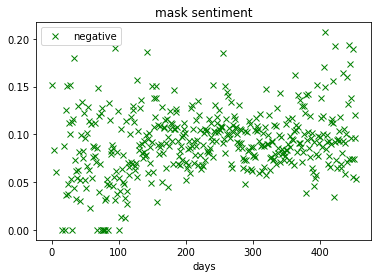

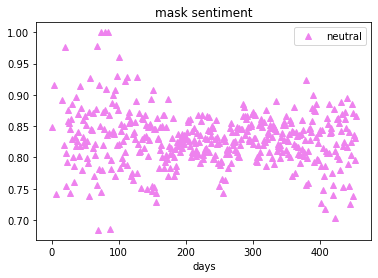

In [12]:
# some exaples of use

masks = key_sentiment(table, 'mask', to_print = 1)

/usr/local/lib/python3.7/dist-packages/numpy/lib/function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
/usr/local/lib/python3.7/dist-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


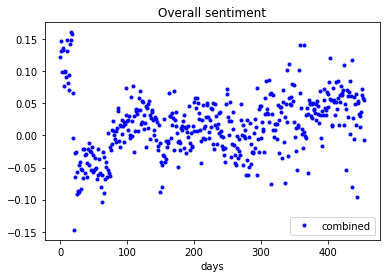

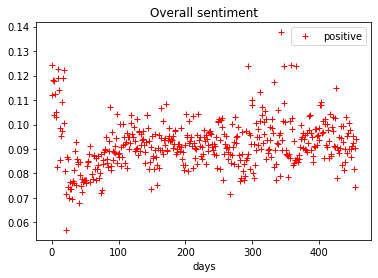

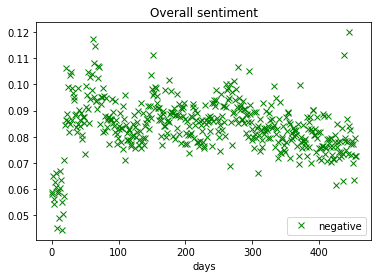

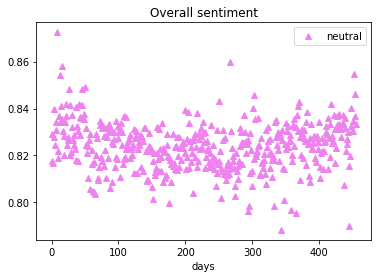

In [16]:
overall = key_sentiment(table, to_print=1)

/usr/local/lib/python3.7/dist-packages/numpy/lib/function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
/usr/local/lib/python3.7/dist-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Text(0.5, 1.0, 'Yearly change')

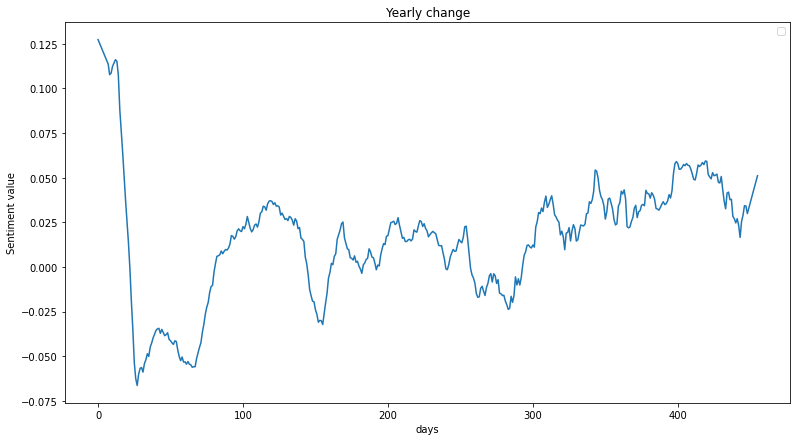

In [27]:
# plotting the yearly change with Savitzky–Golay filter

from scipy import signal as sig
smooth = sig.savgol_filter
y = key_sentiment(table)['combined']
x = list(range(len(y)))

#cleaning nan values
for i in y:
  if str(i) == 'nan':
    y[y.index(i)] = 0

plt.plot(x, smooth(y, 13, 1), '-')
plt.gcf().set_size_inches(13,7)
plt.legend()
plt.xlabel('days')
plt.ylabel('Sentiment value')
plt.title('Yearly change')

/usr/local/lib/python3.7/dist-packages/numpy/lib/function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
/usr/local/lib/python3.7/dist-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


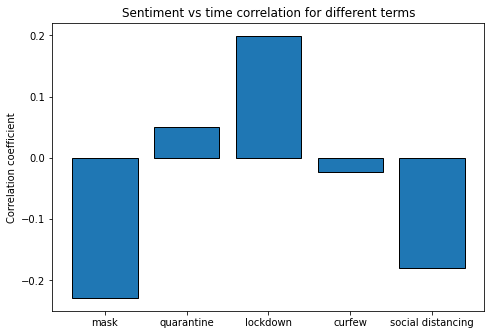

In [30]:
#making a histogram of overall change

#getting the corelation values 

from scipy.stats import linregress as lin

keywords = ['mask', 'quarantine', 'lockdown', 'curfew', 'social distancing']

corelations = []
for word in keywords:

  y = key_sentiment(table, word)['combined']
  x = list(range(len(y)))

  for i in y:
    if str(i) == 'nan':
      # x.remove(x[y.index(i)])
      # y.remove(i)
      y[y.index(i)] = 0

  corelations.append(lin(x,y)[2])

fig = plt.figure()
ax = fig.add_axes([0,0,1,1])
ax.bar(keywords, corelations)
plt.title('Sentiment vs time correlation for different terms')
plt.ylabel('Correlation coefficient')
plt.show()